# Preprocessing

In [226]:
#Plot images function
import matplotlib.pyplot as plt
from PIL import Image

def plotImages(image_path, columns, rows, start_image, type):
    start_image = start_image - 1
    fig = plt.figure(figsize=(20, 12))
    for i in range(1, columns*rows +1):
        if type == 'train':
            start=6
            #000000.jpg
        elif type == 'test':
            start=5
            #00000.jpg
        
        img = Image.open(image_path + "/" + str(start_image + i).zfill(start) + '.jpg') # for test, image -1 
        #print("img name: ", str(i+start_image).zfill(start) + '.jpg')
        fig.add_subplot(rows, columns, i)
        plt.subplots_adjust(wspace=0.01) # set the horizontal space between images
        plt.subplots_adjust(hspace=0.01) # set the vertical space between images
        plt.imshow(img)
        plt.axis('off')
    plt.show()

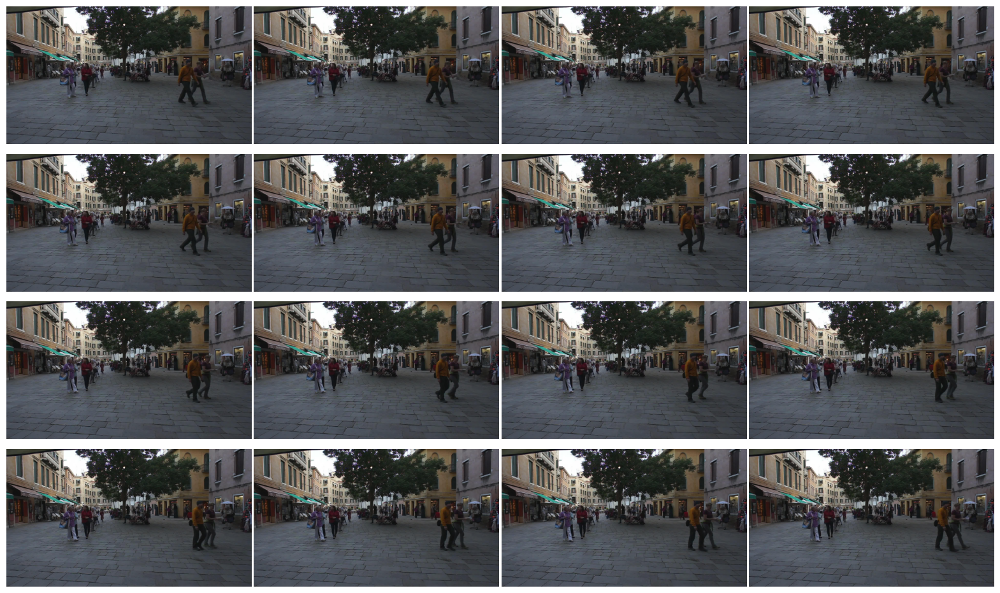

In [222]:
#Plot the images from the first training sequence
plotImages('dataset/MOT17/images/train/MOT17-02-SDP/img1', 4, 4, 1, 'train')

# Training

### Model 1: Full dataset for Training & Testing

In [ ]:
!cd src && python train.py mot --exp_id mot17_model --load_model '../models/ctdet_coco_dla_2x.pth' --data_cfg '../src/lib/cfg/mot17.json' --batch_size 4 --num_epochs 30 
#Best epoch: 29

Using tensorboardX
Fix size testing.
training chunk_sizes: [4]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/mot17_model
Setting up data...
dataset summary
OrderedDict([('mot17', 547.0)])
total # identities: 548
start index
OrderedDict([('mot17', 0)])
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
Namespace(K=500, arch='dla_34', batch_size=4, cat_spec_wh=False, chunk_sizes=[4], conf_thres=0.4, data_cfg='../src/lib/cfg/mot17.json', data_dir='/home/abdulbhutta/Desktop/FairMOT-master/dataset', dataset='jde', debug_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/mot17_model/debug', dense_wh=False, det_thres=0.3, down_ratio=4, exp_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot', exp_id='mot17_model', fix_res=True, gpus=[0], gpus_str='0', head_conv=256, heads={'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}, hide_data_time=False, hm_weight=1, id_loss='ce', id_weight=1, img_size=(1088, 608), input_h=1088, input_res=1

### Model 2: Half Dataset for Training & Half for Testing 

In [101]:
!cd src && python train.py mot --exp_id mot17_half_dla34  --load_model '../models/ctdet_coco_dla_2x.pth' --data_cfg '../src/lib/cfg/mot17_half.json' --batch_size 4 --num_epochs 30  --gpus 0 --arch 'dla_34' 
#Best epoch: 30 or last

Using tensorboardX
Fix size testing.
training chunk_sizes: [4]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/mot17_half_dla34
Setting up data...
dataset summary
OrderedDict([('mot17', 547.0)])
total # identities: 548
start index
OrderedDict([('mot17', 0)])
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
Namespace(K=500, arch='dla_34', batch_size=4, cat_spec_wh=False, chunk_sizes=[4], conf_thres=0.4, data_cfg='../src/lib/cfg/mot17_half.json', data_dir='/home/abdulbhutta/Desktop/FairMOT-master/dataset', dataset='jde', debug_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/mot17_half_dla34/debug', dense_wh=False, det_thres=0.3, down_ratio=4, exp_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot', exp_id='mot17_half_dla34', fix_res=True, gpus=[0], gpus_str='0', head_conv=256, heads={'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}, hide_data_time=False, hm_weight=1, id_loss='ce', id_weight=1, img_size=(1088, 608), input

# Testing Results

### Model 1 (Full Training Dataset) - Best weights (Epoch 29) used for Testing

In [126]:
!cd src && python track.py mot \
    --exp_id MOT17_dla34 \
    --load_model ../models/MOT17_dla34_best.pth \
    --conf_thres 0.4 \
    --val_mot17 True 

Fix size testing.
training chunk_sizes: [6, 6]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/MOT17_dla34
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
Namespace(K=500, arch='dla_34', batch_size=12, cat_spec_wh=False, chunk_sizes=[6, 6], conf_thres=0.4, data_cfg='../src/lib/cfg/data.json', data_dir='/home/abdulbhutta/Desktop/FairMOT-master/dataset', dataset='jde', debug_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/MOT17_dla34/debug', dense_wh=False, det_thres=0.3, down_ratio=4, exp_dir='/home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot', exp_id='MOT17_dla34', fix_res=True, gpus=[2, 3], gpus_str='2, 3', head_conv=256, heads={'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}, hide_data_time=False, hm_weight=1, id_loss='ce', id_weight=1, img_size=(1088, 608), input_h=608, input_res=1088, input_video='../videos/MOT16-03.mp4', input_w=1088, keep_res=False, load_model='../models/MOT17_dla34_best.pth', lr=0.0001, lr_step=[2

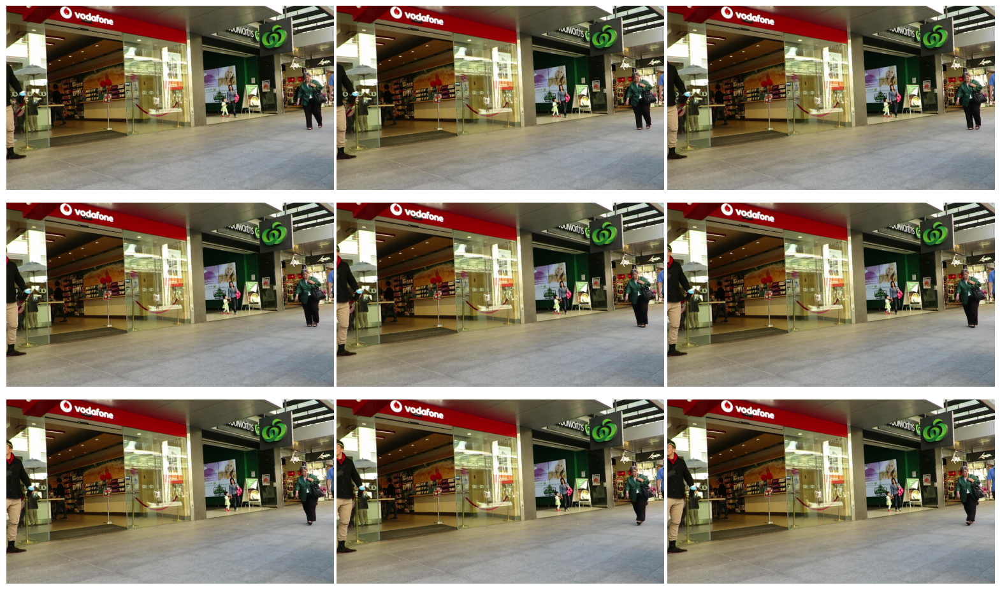

In [218]:
#Plot the first 16 images from frame 300
plotImages("dataset/MOT17/images/train/MOT17-09-SDP/img1", 3, 3, 1, 'train')

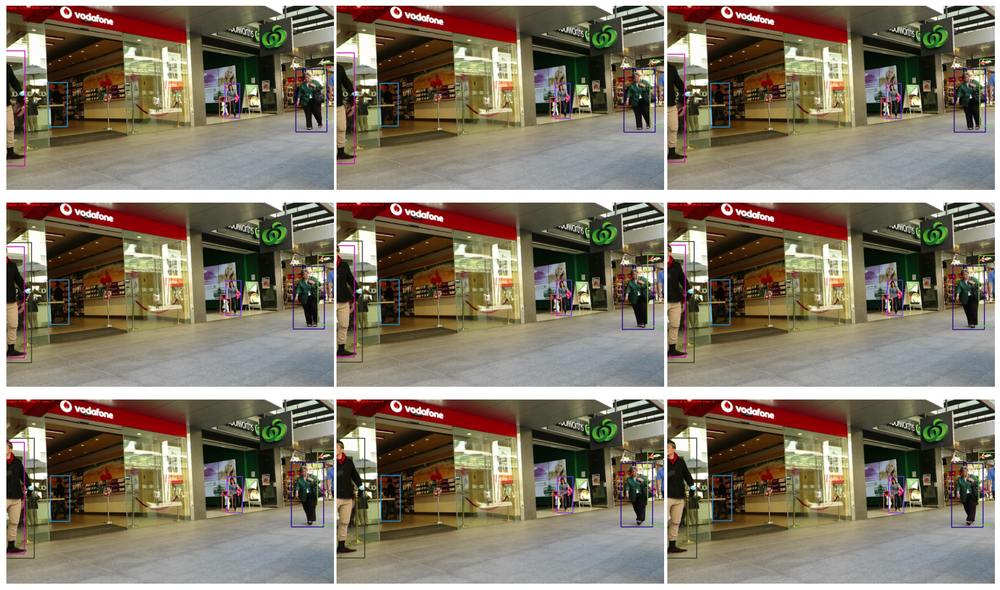

In [219]:
#Plot the Tracking results
plotImages("dataset/MOT17/images/outputs/Mot17_dla34/MOT17-09-SDP", 3, 3, 0, 'test')

# Model 2 (Half-Split) 
### Half Data Training and Testing Results
### Best Epoch: 30

In [125]:
#!python src/track.py mot --load_model models/fairmot_dla34.pth --conf_thres 0.4 --test_mot17 True
!cd src && python track_half.py mot \
    --exp_id MOT17_half_dla    \
    --load_model ../models/model_last.pth  \
    --conf_thres 0.4 \
    --val_mot17 True 

Fix size testing.
training chunk_sizes: [6, 6]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/MOT17_half_dla
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
2024-07-23 02:27:49 [INFO]: start seq: MOT17-02-SDP
CFG DATA PATH:  /home/abdulbhutta/Desktop/FairMOT-master/dataset/MOT17/images/train/MOT17-02-SDP/img1
Creating model...
loaded ../models/model_last.pth, epoch 30
2024-07-23 02:27:54 [INFO]: Processing frame 300 (100000.00 fps)
2024-07-23 02:27:56 [INFO]: Processing frame 320 (15.76 fps)
2024-07-23 02:27:58 [INFO]: Processing frame 340 (17.81 fps)
2024-07-23 02:28:00 [INFO]: Processing frame 360 (17.73 fps)
2024-07-23 02:28:02 [INFO]: Processing frame 380 (17.32 fps)
2024-07-23 02:28:04 [INFO]: Processing frame 400 (17.12 fps)
2024-07-23 02:28:06 [INFO]: Processing frame 420 (17.49 fps)
2024-07-23 02:28:08 [INFO]: Processing frame 440 (17.59 fps)
2024-07-23 02:28:10 [INFO]: Processing frame 460 (17.61 fps)
2024-07-23 02:28:12 [INFO]: Proce

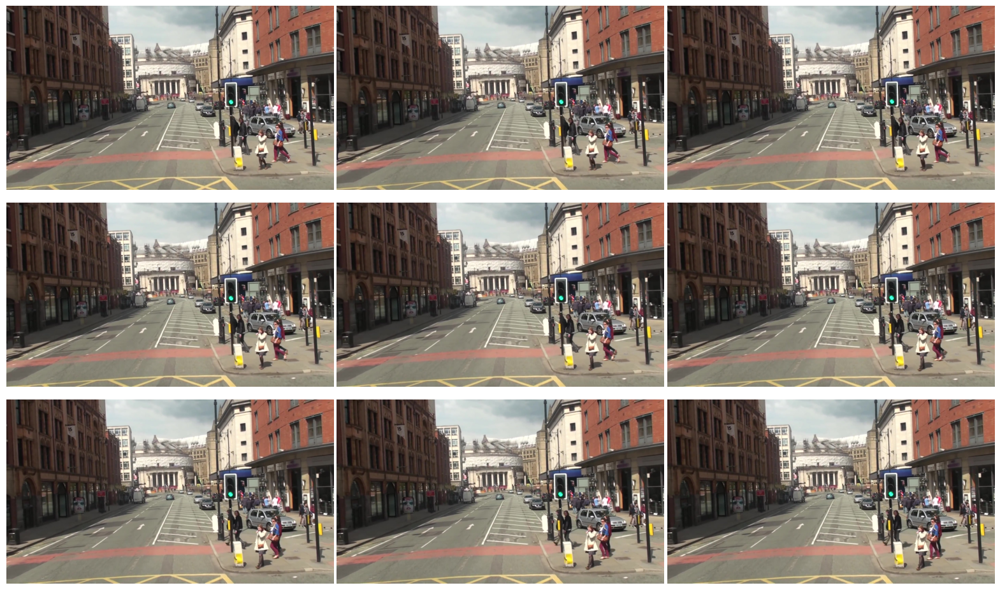

In [220]:
plotImages("dataset/MOT17/images/train/MOT17-13-SDP/img1", 3, 3, 375, 'train')

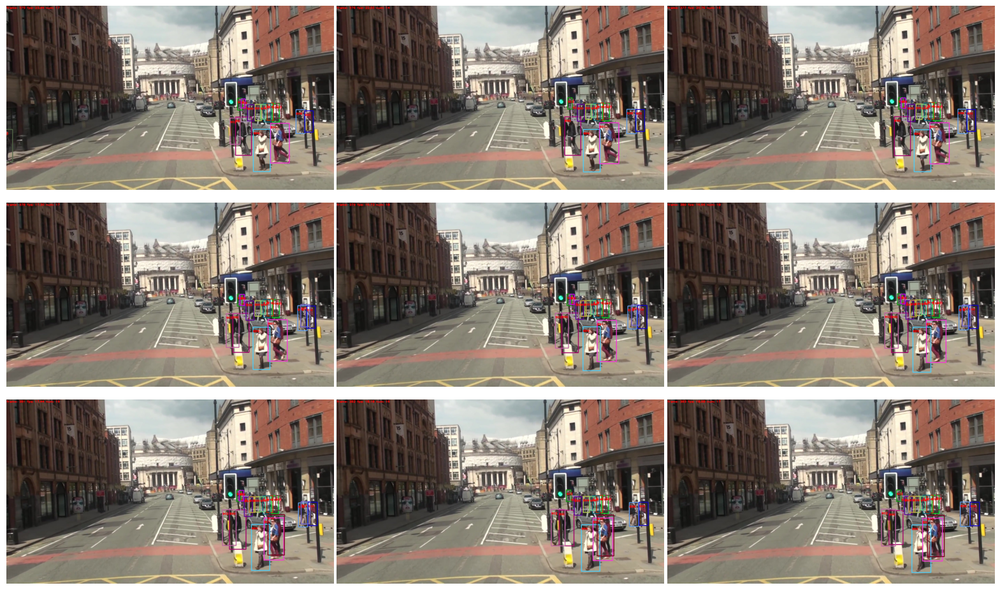

In [221]:
plotImages("dataset/MOT17/images/outputs/MOT17_half_dla/MOT17-13-SDP", 3, 3, 375, 'test')

# Inference

### Run tracker on Demo video

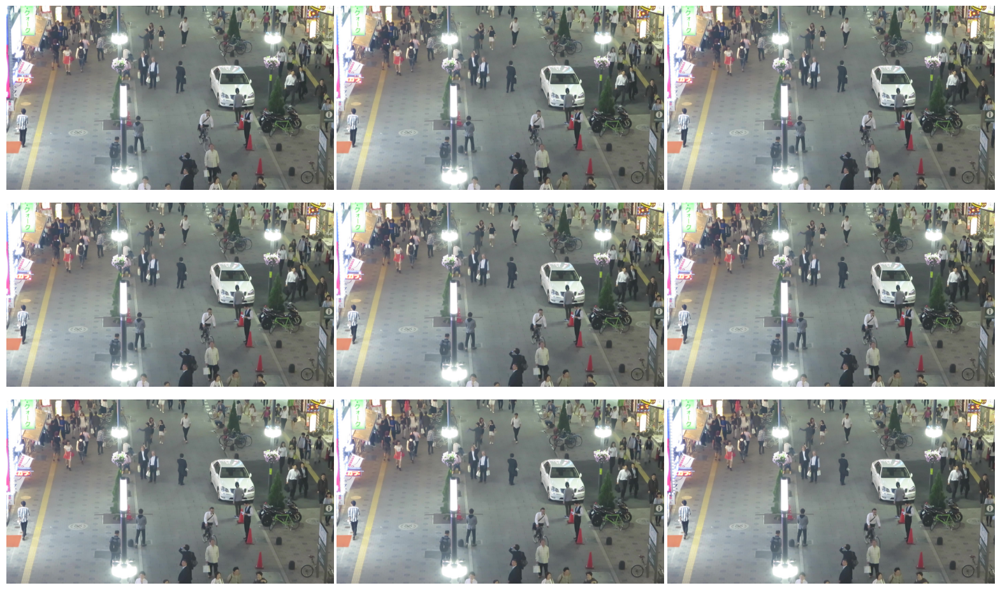

In [243]:
#Plot the demo video images
plotImages("dataset/MOT17/images/test/MOT17-03-SDP/img1", 3, 3, 1, 'train')

In [ ]:
#Model 1 (Full Dataset)
!cd src && python demo.py mot --load_model ../models/MOT17_dla34_best.pth --conf_thres 0.4 --output-root ../demos/results/Full_MOT17

Fix size testing.
training chunk_sizes: [6, 6]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/default
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
2024-07-31 06:31:15 [INFO]: Starting tracking...
Lenth of the video: 1500 frames
Creating model...
loaded ../models/MOT17_dla34_best.pth, epoch 29
2024-07-31 06:31:18 [INFO]: Processing frame 0 (100000.00 fps)
2024-07-31 06:31:19 [INFO]: Processing frame 20 (16.77 fps)
2024-07-31 06:31:21 [INFO]: Processing frame 40 (17.93 fps)
2024-07-31 06:31:22 [INFO]: Processing frame 60 (18.59 fps)
2024-07-31 06:31:23 [INFO]: Processing frame 80 (18.97 fps)
2024-07-31 06:31:25 [INFO]: Processing frame 100 (19.19 fps)
2024-07-31 06:31:26 [INFO]: Processing frame 120 (19.10 fps)
2024-07-31 06:31:27 [INFO]: Processing frame 140 (19.32 fps)
2024-07-31 06:31:29 [INFO]: Processing frame 160 (19.23 fps)
2024-07-31 06:31:30 [INFO]: Processing frame 180 (19.32 fps)
2024-07-31 06:31:32 [INFO]: Processing frame 200 (19

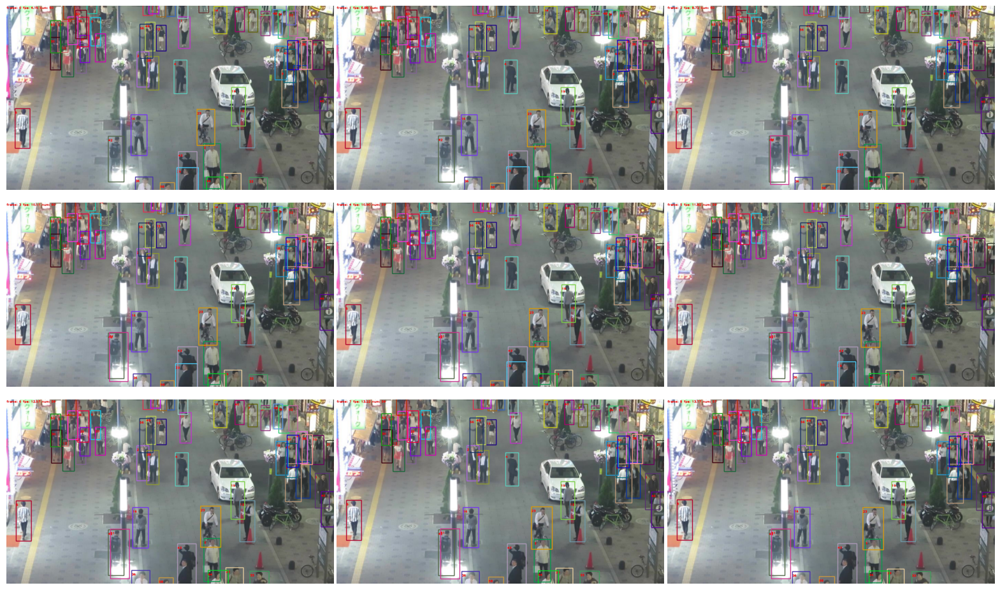

In [ ]:
#Plot the images for the demo video (Full MOT17 Model)
plotImages("demos/results/Full_MOT17/frame", 3, 3, 0, 'test')

In [245]:
#Model 2 (Half_MOT17)
!cd src && python demo.py mot --load_model ../models/model_last.pth --conf_thres 0.4 --output-root ../demos/results/Half_MOT17

Fix size testing.
training chunk_sizes: [6, 6]
The output will be saved to  /home/abdulbhutta/Desktop/FairMOT-master/src/lib/../../exp/mot/default
heads {'hm': 1, 'wh': 4, 'id': 128, 'reg': 2}
2024-07-31 06:47:07 [INFO]: Starting tracking...
Lenth of the video: 1500 frames
Creating model...
loaded ../models/model_last.pth, epoch 30
2024-07-31 06:47:09 [INFO]: Processing frame 0 (100000.00 fps)
2024-07-31 06:47:11 [INFO]: Processing frame 20 (14.72 fps)
2024-07-31 06:47:12 [INFO]: Processing frame 40 (16.95 fps)
2024-07-31 06:47:14 [INFO]: Processing frame 60 (17.54 fps)
2024-07-31 06:47:15 [INFO]: Processing frame 80 (18.23 fps)
2024-07-31 06:47:16 [INFO]: Processing frame 100 (18.70 fps)
2024-07-31 06:47:18 [INFO]: Processing frame 120 (18.68 fps)
2024-07-31 06:47:19 [INFO]: Processing frame 140 (18.88 fps)
2024-07-31 06:47:21 [INFO]: Processing frame 160 (18.87 fps)
2024-07-31 06:47:22 [INFO]: Processing frame 180 (18.86 fps)
2024-07-31 06:47:23 [INFO]: Processing frame 200 (18.95 fp

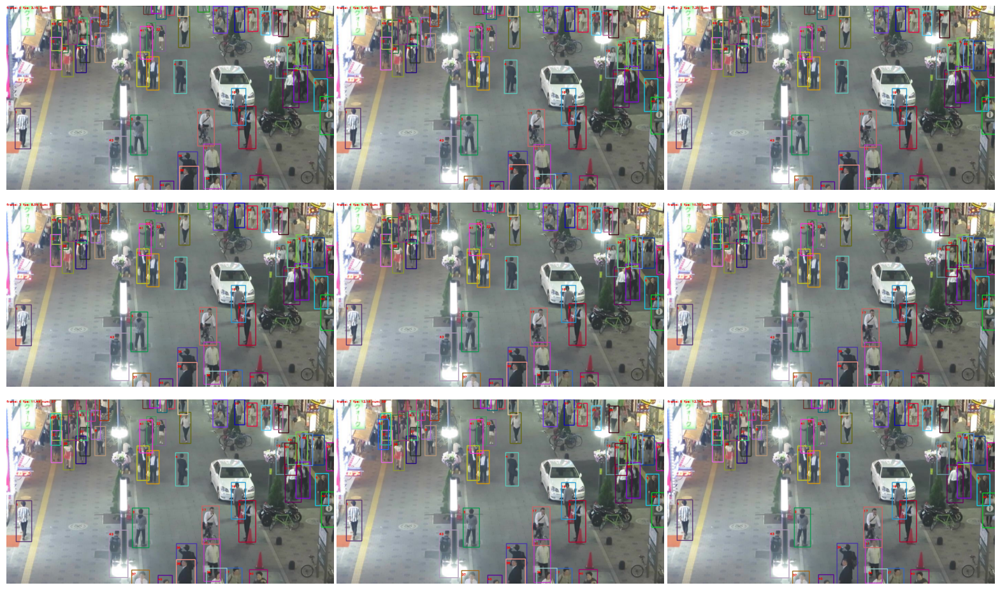

In [238]:
#Plot the images for the demo video
plotImages("demos/results/Half_MOT17/frame", 3, 3, 0, 'test')